## Homework Assignment 9

**Question 1:** Select a short video with at least 3 persons and create a new movie from this video with a face tracker (each person’s face needs to be tracked by a rectangle of a different color) (50pt). See, for example, the video in: https://github.com/ageitgey/face_recognition

**Bonus:** Select a video with at least two animals (dog/cat/lion/tiger...), and create a video with an animal tracker (10pt).

In [ ]:
!pip install face_recognition

     |████████████████████████████████| 100.2MB 30kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566173 sha256=837bba537d557939056fb5e29e2172975c94ec0f880bbc6a914d005b5b2e37bc
  Stored in directory: /root/.cache/pip/wheels/d2/99/18/59c6c8f01e39810415c0e63f5bede7d83dfb0ffc039865465f
Successfully built face-recognition-models


In [ ]:
!pip install turicreate

     |████████████████████████████████| 92.0MB 43kB/s 
     |████████████████████████████████| 3.6MB 47.8MB/s 
     |████████████████████████████████| 327kB 42.0MB/s 
     |████████████████████████████████| 86.4MB 40kB/s 
     |████████████████████████████████| 3.5MB 31.2MB/s 
     |████████████████████████████████| 18.3MB 177kB/s 
     |████████████████████████████████| 51kB 8.2MB/s 
     |████████████████████████████████| 450kB 55.4MB/s 
     |████████████████████████████████| 3.8MB 47.4MB/s 
  Created wheel for resampy: filename=resampy-0.2.1-cp37-none-any.whl size=320845 sha256=448f29f853f6967dd08fbcc465b820316311093240bf9a1f938c679921ac1b21
  Stored in directory: /root/.cache/pip/wheels/ff/4f/ed/2e6c676c23efe5394bb40ade50662e90eb46e29b48324c5f9b
  Created wheel for prettytable: filename=prettytable-0.7.2-cp37-none-any.whl size=13700 sha256=239606ae61c5e6b7d4f1e03158fd1dff371219b9239ee8c44a81f8e6b778c23e
  Stored in directory: /root/.cache/pip/wheels/80/34/1c/3967380d9676d162cb5951

# 1.1

In [ ]:
import face_recognition
import cv2
from moviepy.editor import *

# This is a demo of running face recognition on a video file and saving the results to a new video file.
#
# PLEASE NOTE: This example requires OpenCV (the `cv2` library) to be installed only to read from your webcam.
# OpenCV is *not* required to use the face_recognition library. It's only required if you want to run this
# specific demo. If you have trouble installing it, try any of the other demos that don't require it instead.


# Load some sample pictures and learn how to recognize them.
biden_image = face_recognition.load_image_file('/content/biden.jpg')
biden_face_encoding = face_recognition.face_encodings(biden_image)[0]

biden_image_2 = face_recognition.load_image_file('/content/biden2.jpg')
biden_face_encoding_2 = face_recognition.face_encodings(biden_image_2)[0]

biden_image_3 = face_recognition.load_image_file('/content/biden3.jpg')
biden_face_encoding_3 = face_recognition.face_encodings(biden_image_3)[0]

obama_image = face_recognition.load_image_file('/content/obama2.jpg')
obama_face_encoding = face_recognition.face_encodings(obama_image)[0]

obama_image_2 = face_recognition.load_image_file('/content/obama3.jpg')
obama_face_encoding_2 = face_recognition.face_encodings(obama_image_2)[0]

obama_image_3 = face_recognition.load_image_file('/content/obama.jpg')
obama_face_encoding_3 = face_recognition.face_encodings(obama_image_3)[0]

known_faces_biden = [
    biden_face_encoding,
    biden_face_encoding_2,
    biden_face_encoding_3
]
known_faces_obama = [
  obama_face_encoding,
  obama_face_encoding_2,
  obama_face_encoding_3
]
colors = {'biden':(238,237,9), 'obama': (255, 0, 0)}

# Open the input movie file
input_movie = cv2.VideoCapture('/content/use-this.gif')
length = int(input_movie.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(input_movie.get(3))
frame_height = int(input_movie.get(4))
fourcc = cv2.VideoWriter_fourcc('M','J','P','G')
output_movie = cv2.VideoWriter('output.avi', fourcc, 17, (frame_width, frame_height))

# Initialize some variables
face_locations = []
face_encodings = []
face_names = []
process_this_frame = True

elapsed = int(input_movie.get(cv2.CAP_PROP_FRAME_COUNT)) 
name = ''
count = 1
while True:
    # Grab a single frame of video
    ret, frame = input_movie.read()
    if not ret:
        break
    # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
    rgb_small_frame = frame[:, :, ::-1]

    # Find all the faces and face encodings in the current frame of video
    face_locations = face_recognition.face_locations(rgb_small_frame)
    face_encodings = face_recognition.face_encodings(rgb_small_frame, face_locations)

    
    face_names = []
    for face_encoding in face_encodings:
        # See if the face is a match for the known face(s)
        matches_biden = face_recognition.compare_faces(known_faces_biden, face_encoding, tolerance=0.465)
               
        matches_obama = face_recognition.compare_faces(known_faces_obama, face_encoding, tolerance=0.68)
       
        # If a match was found in known_face_encodings, just use the first one.
        # if True in matches:
        #     first_match_index = matches.index(True)
        #    name = known_face_names[first_match_index]
        if matches_biden[0] or matches_biden[1] or matches_biden[2]:
          name = 'biden'
        elif matches_obama[0] or matches_obama[1] or matches_obama[2]:
          name = 'obama'
        # elif matches[1]:
        #   name = 'biden'
        else:
          continue
        face_names.append(name)
    
    # Display the results
    for (top, right, bottom, left), name in zip(face_locations, face_names):
        
        col = colors[name]
        # Draw a box around the face
        cv2.rectangle(frame, (left, top), (right, bottom), col, 4)

        # Draw a label with a name below the face
        cv2.rectangle(frame, (left, bottom - 15), (right, bottom), col, cv2.FILLED)
        font = cv2.FONT_HERSHEY_DUPLEX
        cv2.putText(frame, name, (left + 6, bottom - 6), font, 1.0, (255, 255, 255), 1)
    
    print(str(count)+' out of:' , elapsed)
    output_movie.write(frame)
    count = count + 1
output_movie.release()
input_movie.release()
cv2.destroyAllWindows()

In [ ]:
from IPython.display import Image 
clip = VideoFileClip('/content/output.avi')
clip.ipython_display(width=840,autoplay=1, loop=1)

100%|██████████| 131/131 [00:02<00:00, 58.52it/s]


**Question 2:** Create an image classifier that can identify if a person in the image wears a facial mask (45pt). Evaluate the classifier precision (5pt)

# 2

In [ ]:
# Installing the Kaggle package
import json
!pip install kaggle 
!mkdir /root/.kaggle/

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"grinshpanyonatan","key":"??"}

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle/’: File exists


In [ ]:
!mkdir ./datasets
!mkdir ./datasets/masks

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d spandanpatnaik09/face-mask-detectormask-not-mask-incorrect-mask -p ./datasets/masks
!unzip ./datasets/masks/*.zip  -d ./datasets/masks/

In [ ]:
import turicreate as tc
import turicreate.aggregate as agg
DATASET_PATH = '/content/datasets/mask'
sf_with_mask = tc.image_analysis.load_images('/content/datasets/masks/dataset/with_mask', with_path=True)
sf_with_mask

path,image
/content/datasets/masks/dataset/with_mask/0-with- ...,Height: 350 Width: 525
/content/datasets/masks/dataset/with_mask/1-with- ...,Height: 350 Width: 525
/content/datasets/masks/dataset/with_mask/10-w ...,Height: 350 Width: 233
/content/datasets/masks/dataset/with_mask/100- ...,Height: 428 Width: 320
/content/datasets/masks/dataset/with_mask/101- ...,Height: 428 Width: 320
/content/datasets/masks/dataset/with_mask/103- ...,Height: 428 Width: 320
/content/datasets/masks/dataset/with_mask/104- ...,Height: 341 Width: 324
/content/datasets/masks/dataset/with_mask/105- ...,Height: 244 Width: 214
/content/datasets/masks/dataset/with_mask/106- ...,Height: 484 Width: 428
/content/datasets/masks/dataset/with_mask/107- ...,Height: 433 Width: 320


,path,image
0,/content/datasets/masks/dataset/with_mask/0-with-mask.jpg,
1,/content/datasets/masks/dataset/with_mask/1-with-mask.jpg,
2,/content/datasets/masks/dataset/with_mask/10-with-mask.jpg,
3,/content/datasets/masks/dataset/with_mask/100-with-mask.jpg,
4,/content/datasets/masks/dataset/with_mask/101-with-mask.jpg,
5,/content/datasets/masks/dataset/with_mask/103-with-mask.jpg,
6,/content/datasets/masks/dataset/with_mask/104-with-mask.jpg,
7,/content/datasets/masks/dataset/with_mask/105-with-mask.jpg,
8,/content/datasets/masks/dataset/with_mask/106-with-mask.jpg,
9,/content/datasets/masks/dataset/with_mask/107-with-mask.jpg,

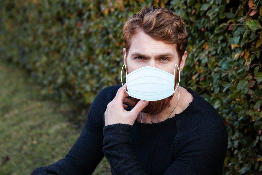
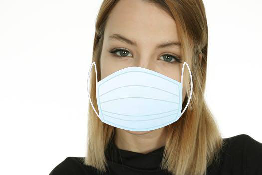
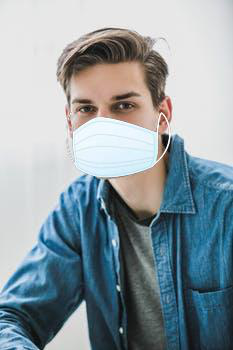
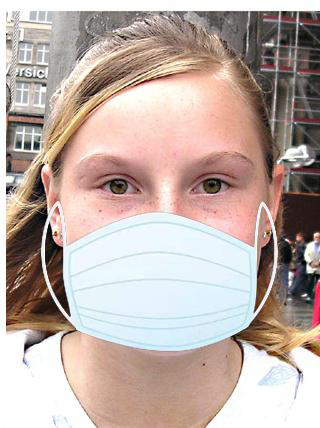
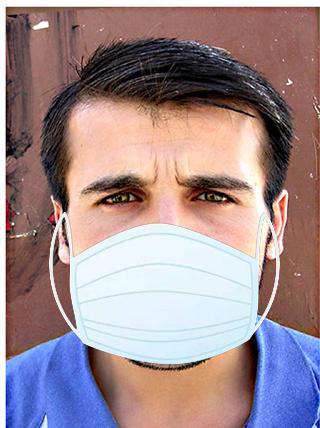
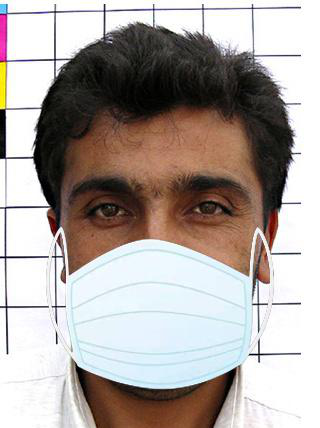
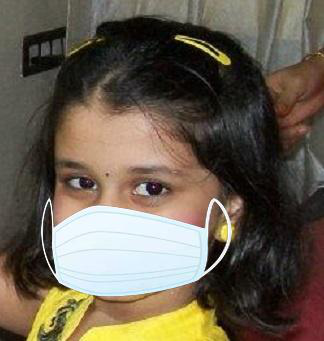
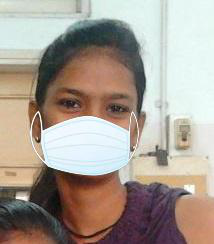
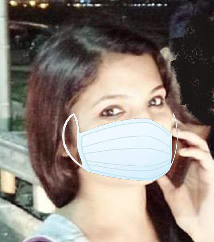
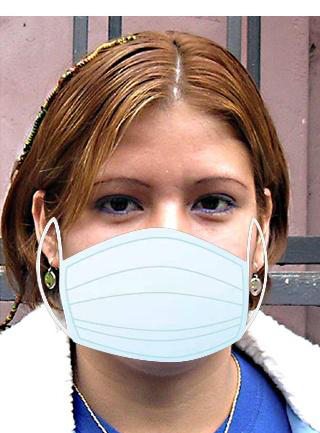

In [ ]:
sf_mask_explore = sf_with_mask[:10]
sf_mask_explore.explore()

In [ ]:
import turicreate as tc
sf_withOUT_mask = tc.image_analysis.load_images('/content/datasets/masks/dataset/without_mask', with_path=True)
sf_withOUT_mask

path,image
/content/datasets/masks/dataset/without_mask/0 ...,Height: 270 Width: 180
/content/datasets/masks/dataset/without_mask/1 ...,Height: 225 Width: 154
/content/datasets/masks/dataset/without_mask/1 ...,Height: 366 Width: 274
/content/datasets/masks/dataset/without_mask/1 ...,Height: 428 Width: 320
/content/datasets/masks/dataset/without_mask/1 ...,Height: 428 Width: 320
/content/datasets/masks/dataset/without_mask/1 ...,Height: 433 Width: 320
/content/datasets/masks/dataset/without_mask/1 ...,Height: 341 Width: 324
/content/datasets/masks/dataset/without_mask/1 ...,Height: 244 Width: 214
/content/datasets/masks/dataset/without_mask/1 ...,Height: 484 Width: 428
/content/datasets/masks/dataset/without_mask/1 ...,Height: 433 Width: 320


,path,image
0,/content/datasets/masks/dataset/without_mask/0.jpg,
1,/content/datasets/masks/dataset/without_mask/1.jpg,
2,/content/datasets/masks/dataset/without_mask/10.jpg,
3,/content/datasets/masks/dataset/without_mask/100.jpg,
4,/content/datasets/masks/dataset/without_mask/101.jpg,
5,/content/datasets/masks/dataset/without_mask/102.jpg,
6,/content/datasets/masks/dataset/without_mask/104.jpg,
7,/content/datasets/masks/dataset/without_mask/105.jpg,
8,/content/datasets/masks/dataset/without_mask/106.jpg,
9,/content/datasets/masks/dataset/without_mask/107.jpg,

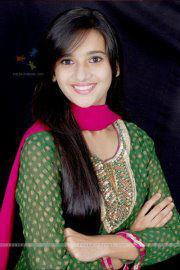
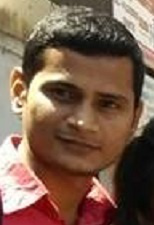
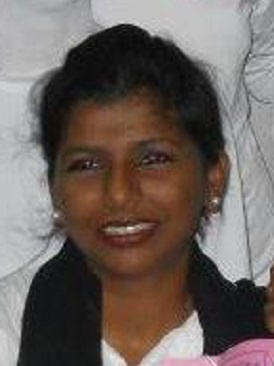
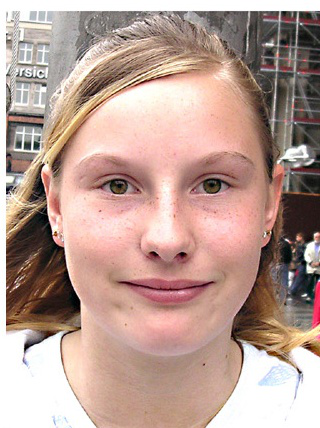
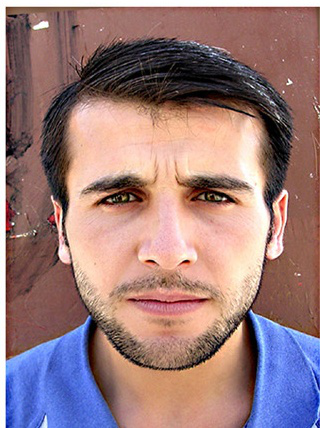
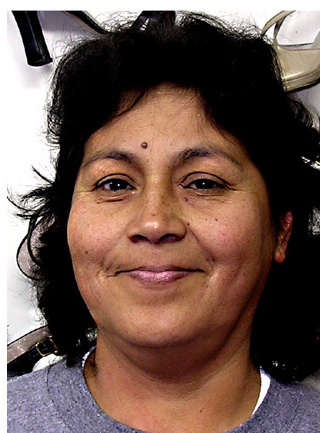
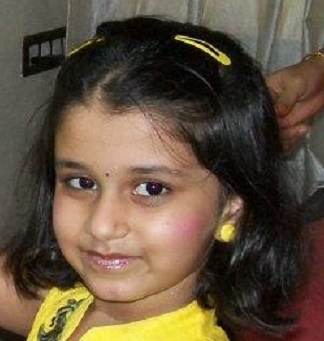
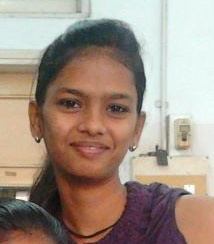
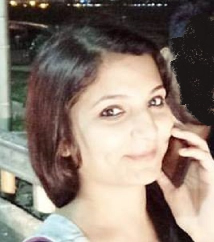
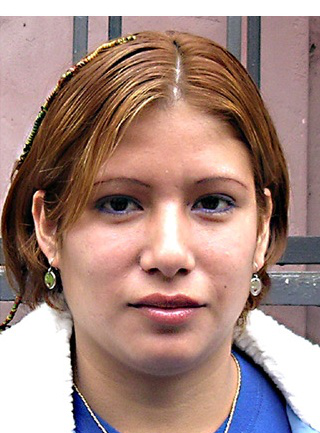

In [ ]:
sf_no_mask_explore = sf_withOUT_mask[:10]
sf_no_mask_explore.explore()

In [ ]:
sf_with_mask['mask'] = sf_with_mask.apply(lambda a: 'yes')
sf_withOUT_mask['mask'] = sf_withOUT_mask.apply(lambda a: 'no')

In [ ]:
sf_with_mask

path,image,mask
/content/datasets/masks/dataset/with_mask/0-with- ...,Height: 350 Width: 525,yes
/content/datasets/masks/dataset/with_mask/1-with- ...,Height: 350 Width: 525,yes
/content/datasets/masks/dataset/with_mask/10-w ...,Height: 350 Width: 233,yes
/content/datasets/masks/dataset/with_mask/100- ...,Height: 428 Width: 320,yes
/content/datasets/masks/dataset/with_mask/101- ...,Height: 428 Width: 320,yes
/content/datasets/masks/dataset/with_mask/103- ...,Height: 428 Width: 320,yes
/content/datasets/masks/dataset/with_mask/104- ...,Height: 341 Width: 324,yes
/content/datasets/masks/dataset/with_mask/105- ...,Height: 244 Width: 214,yes
/content/datasets/masks/dataset/with_mask/106- ...,Height: 484 Width: 428,yes
/content/datasets/masks/dataset/with_mask/107- ...,Height: 433 Width: 320,yes


In [ ]:
sf_withOUT_mask

path,image,mask
/content/datasets/masks/dataset/without_mask/0 ...,Height: 270 Width: 180,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 225 Width: 154,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 366 Width: 274,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 428 Width: 320,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 428 Width: 320,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 433 Width: 320,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 341 Width: 324,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 244 Width: 214,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 484 Width: 428,no
/content/datasets/masks/dataset/without_mask/1 ...,Height: 433 Width: 320,no


In [ ]:
from turicreate.toolkits import _image_feature_extractor, _pre_trained_models

def get_images_features_vector(dataset, target, feature="image", model_name='resnet-50'):
    #ptModel = _pre_trained_models.MODELS[model_name]()
    ptModel = tc.toolkits._pre_trained_models.ResNetImageClassifier()
    feature_extractor = tc.toolkits._image_feature_extractor._create_feature_extractor(model_name)
    extracted_features = tc.SFrame({
        target: dataset[target],
        '__image_features__': feature_extractor.extract_features(dataset, feature),
        })
    dataset['image_features'] = extracted_features['__image_features__']
    return dataset

sf_with_mask = get_images_features_vector(sf_with_mask, 'mask')
sf_with_mask

Download completed: /var/tmp/model_cache/resnet-50-TuriCreate-6.0.h5


path,image,mask,image_features
/content/datasets/masks/dataset/with_mask/0-with- ...,Height: 350 Width: 525,yes,"[0.02893264964222908,0.0, 0.1364198476076126, ..."
/content/datasets/masks/dataset/with_mask/1-with- ...,Height: 350 Width: 525,yes,"[0.11605235189199448,0.0, 0.6353901624679565, ..."
/content/datasets/masks/dataset/with_mask/10-w ...,Height: 350 Width: 233,yes,"[0.19425228238105774,0.0, 1.1466472148895264, ..."
/content/datasets/masks/dataset/with_mask/100- ...,Height: 428 Width: 320,yes,"[0.3052581548690796, 0.0,0.176949143409729, ..."
/content/datasets/masks/dataset/with_mask/101- ...,Height: 428 Width: 320,yes,"[0.5073779821395874, 0.0,0.6478877067565918, ..."
/content/datasets/masks/dataset/with_mask/103- ...,Height: 428 Width: 320,yes,"[0.5236123204231262, 0.0,0.4130527377128601, ..."
/content/datasets/masks/dataset/with_mask/104- ...,Height: 341 Width: 324,yes,"[0.14327114820480347,0.0, 0.33177438378334 ..."
/content/datasets/masks/dataset/with_mask/105- ...,Height: 244 Width: 214,yes,"[0.10220283269882202,0.0, 0.1534808725118637, ..."
/content/datasets/masks/dataset/with_mask/106- ...,Height: 484 Width: 428,yes,"[0.16391943395137787,0.0, 0.46560734510421 ..."
/content/datasets/masks/dataset/with_mask/107- ...,Height: 433 Width: 320,yes,"[0.25101980566978455,0.0, 0.43291881680488 ..."


In [ ]:
sf_withOUT_mask = get_images_features_vector(sf_withOUT_mask, 'mask')
sf_withOUT_mask

path,image,mask,image_features
/content/datasets/masks/dataset/without_mask/0 ...,Height: 270 Width: 180,no,"[0.1658250391483307, 0.0,0.26141074299812317, ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 225 Width: 154,no,"[0.08929693698883057,0.0, 1.2761406898498535, ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 366 Width: 274,no,"[0.047446902841329575,0.0, 0.8155898451805115, ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 428 Width: 320,no,"[0.12239310145378113,0.0, 0.19962918758392 ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 428 Width: 320,no,"[0.029258720576763153,0.0, 0.4071442782878876, ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 433 Width: 320,no,"[0.08823003619909286,0.0, 0.34202051162719 ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 341 Width: 324,no,"[0.024274149909615517,0.0, 0.3619523346424103, ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 244 Width: 214,no,"[0.027149006724357605,0.0, 0.4096163511276245, ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 484 Width: 428,no,"[0.11364154517650604,0.0, 0.6956537961959839, ..."
/content/datasets/masks/dataset/without_mask/1 ...,Height: 433 Width: 320,no,"[0.0, 0.0,0.6263124346733093, ..."


In [ ]:
sf = sf_with_mask.append(sf_withOUT_mask)
sf

path,image,mask,image_features
/content/datasets/masks/dataset/with_mask/0-with- ...,Height: 350 Width: 525,yes,"[0.02893264964222908,0.0, 0.1364198476076126, ..."
/content/datasets/masks/dataset/with_mask/1-with- ...,Height: 350 Width: 525,yes,"[0.11605235189199448,0.0, 0.6353901624679565, ..."
/content/datasets/masks/dataset/with_mask/10-w ...,Height: 350 Width: 233,yes,"[0.19425228238105774,0.0, 1.1466472148895264, ..."
/content/datasets/masks/dataset/with_mask/100- ...,Height: 428 Width: 320,yes,"[0.3052581548690796, 0.0,0.176949143409729, ..."
/content/datasets/masks/dataset/with_mask/101- ...,Height: 428 Width: 320,yes,"[0.5073779821395874, 0.0,0.6478877067565918, ..."
/content/datasets/masks/dataset/with_mask/103- ...,Height: 428 Width: 320,yes,"[0.5236123204231262, 0.0,0.4130527377128601, ..."
/content/datasets/masks/dataset/with_mask/104- ...,Height: 341 Width: 324,yes,"[0.14327114820480347,0.0, 0.33177438378334 ..."
/content/datasets/masks/dataset/with_mask/105- ...,Height: 244 Width: 214,yes,"[0.10220283269882202,0.0, 0.1534808725118637, ..."
/content/datasets/masks/dataset/with_mask/106- ...,Height: 484 Width: 428,yes,"[0.16391943395137787,0.0, 0.46560734510421 ..."
/content/datasets/masks/dataset/with_mask/107- ...,Height: 433 Width: 320,yes,"[0.25101980566978455,0.0, 0.43291881680488 ..."


visualize the answer

In [ ]:
import numpy as np
import pandas as pd
from sklearn.manifold import TSNE

X = []
for v in sf['image_features']:
    X.append(v)
X = np.array(X)
print("Computed X: ", X.shape)
X_embedded = TSNE(n_components=2,perplexity=100, n_iter=5000, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)
df = pd.DataFrame(columns=['x', 'y', 'mask'])
df['x'], df['y'], df['mask'] = X_embedded[:,0], X_embedded[:,1], sf['mask']
df

Computed X:  (1376, 2048)
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 1376 samples in 0.201s...
[t-SNE] Computed neighbors for 1376 samples in 6.992s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1376
[t-SNE] Computed conditional probabilities for sample 1376 / 1376
[t-SNE] Mean sigma: 4.595471
[t-SNE] Computed conditional probabilities in 0.239s
[t-SNE] Iteration 50: error = 55.0030136, gradient norm = 0.1725675 (50 iterations in 0.851s)
[t-SNE] Iteration 100: error = 54.2405624, gradient norm = 0.1551537 (50 iterations in 0.738s)
[t-SNE] Iteration 150: error = 54.0240250, gradient norm = 0.1435590 (50 iterations in 0.819s)
[t-SNE] Iteration 200: error = 53.9678955, gradient norm = 0.1352665 (50 iterations in 0.719s)
[t-SNE] Iteration 250: error = 53.8941841, gradient norm = 0.1460825 (50 iterations in 0.773s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.894184
[t-SNE] Iteration 300: error = 0.9207439, gradient norm = 0.000860

,x,y,mask
0,7.895833,-19.299006,yes
1,-5.526180,-33.099274,yes
2,-3.625530,-17.302267,yes
3,3.892673,-36.409325,yes
4,-0.419060,-36.620087,yes
...,...,...,...
1371,-1.086859,47.641796,no
1372,-3.729573,46.529819,no
1373,-3.584464,46.489334,no
1374,4.124383,13.167395,no


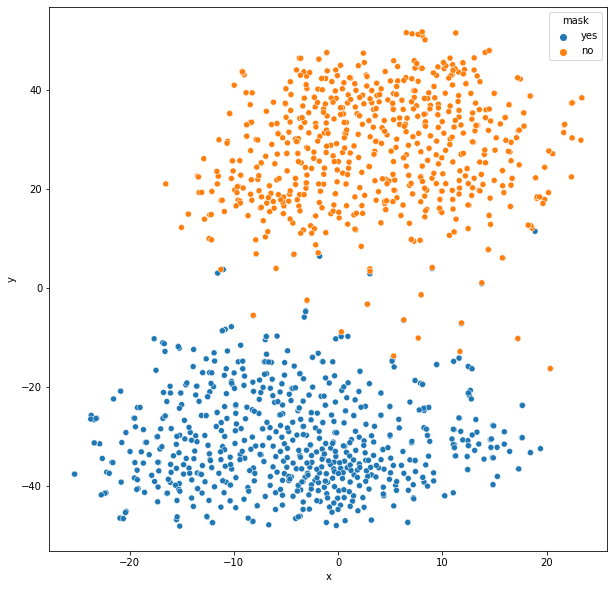

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
c_set = set(df['mask'])
d = dict(zip(c_set, range(len(c_set))))
colors = [d[g] for g in df["mask"]]


plt.figure(figsize=(10,10)) 
sns.scatterplot(x="x", y="y", hue="mask", data=df)

classification method 1

In [ ]:
train, test = sf.random_split(0.8)

In [ ]:
model = tc.image_classifier.create(train['image','mask'], target='mask')
predictions = model.predict(test['image','mask'])

Performing feature extraction on resized images...
Completed   64/1090
Completed  128/1090
Completed  192/1090
Completed  256/1090
Completed  320/1090
Completed  384/1090
Completed  448/1090
Completed  512/1090
Completed  576/1090
Completed  640/1090
Completed  704/1090
Completed  768/1090
Completed  832/1090
Completed  896/1090
Completed  960/1090
Completed 1024/1090
Completed 1088/1090
Completed 1090/1090
PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Logistic regression:

--------------------------------------------------------

Number of examples          : 1035

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 2048

Number of coefficients      : 2049

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 1.236811     | 0.831884          | 0.818182            |

| 1         | 6        | 0.250000  | 1.435500     | 0.977778          | 0.963636            |

| 2         | 9        | 1.250000  | 1.697307     | 0.990338          | 1.000000            |

| 3         | 11       | 1.250000  | 1.909871     | 0.995169          | 1.000000            |

| 4         | 13       | 1.250000  | 2.110027     | 0.996135          | 1.000000            |

| 9         | 25       | 5.811386  | 3.141136     | 1.000000          | 1.000000            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(list(test['mask']), list(predictions))

1.0

classification method 2

In [ ]:
cls = tc.boosted_trees_classifier.create(train,target="mask", features=["image_features"], max_iterations=100)

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 1035

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 2048

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.116941     | 1.000000          | 0.963636            | 0.440822          | 0.459933            |

| 2         | 0.231778     | 1.000000          | 0.981818            | 0.300428          | 0.325884            |

| 3         | 0.331014     | 1.000000          | 0.981818            | 0.211572          | 0.232556            |

| 4         | 0.436029     | 1.000000          | 0.981818            | 0.152005          | 0.169350            |

| 5         | 0.539893     | 1.000000          | 0.981818            | 0.110694          | 0.135061            |

| 10        | 1.005833     | 1.000000          | 0.981818            | 0.025685          | 0.058289            |

| 50        | 3.817748     | 1.000000          | 0.981818            | 0.000405          | 0.019418            |

| 100       | 5.574790     | 1.000000          | 0.981818            | 0.000193          | 0.018826            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

In [ ]:
cls.evaluate(test)

{'accuracy': 1.0, 'auc': 1.0000000000000002, 'confusion_matrix': Columns:
 	target_label	str
 	predicted_label	str
 	count	int
 
 Rows: 2
 
 Data:
 +--------------+-----------------+-------+
 | target_label | predicted_label | count |
 +--------------+-----------------+-------+
 |      no      |        no       |  149  |
 |     yes      |       yes       |  137  |
 +--------------+-----------------+-------+
 [2 rows x 3 columns], 'f1_score': 1.0, 'log_loss': 0.002230799808849355, 'precision': 1.0, 'recall': 1.0, 'roc_curve': Columns:
 	threshold	float
 	fpr	float
 	tpr	float
 	p	int
 	n	int
 
 Rows: 1001
 
 Data:
 +-----------+----------------------+-----+-----+-----+
 | threshold |         fpr          | tpr |  p  |  n  |
 +-----------+----------------------+-----+-----+-----+
 |    0.0    |         1.0          | 1.0 | 137 | 149 |
 |   0.001   | 0.020134228187919462 | 1.0 | 137 | 149 |
 |   0.002   | 0.013422818791946308 | 1.0 | 137 | 149 |
 |   0.003   | 0.013422818791946308 | 1.0 |